In [20]:
# import libraries


In [22]:
!pip install pydicom Pillow matplotlib

In [24]:
import os
import random
import pydicom
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

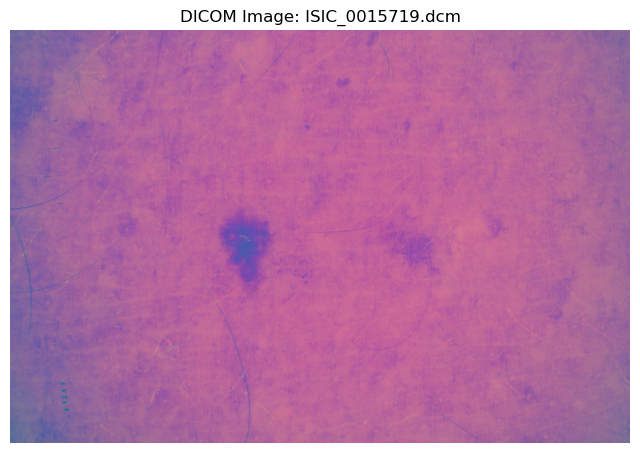

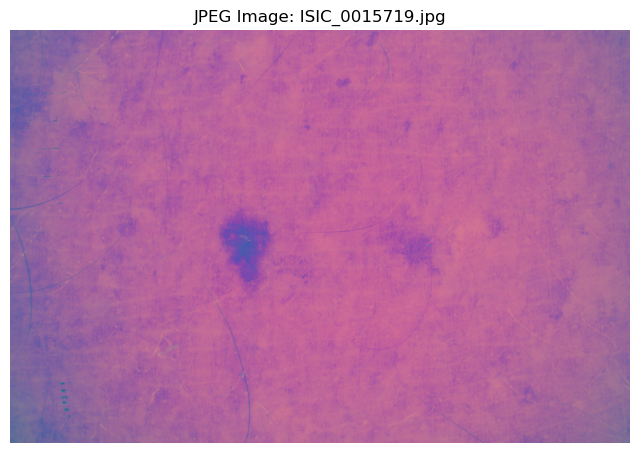

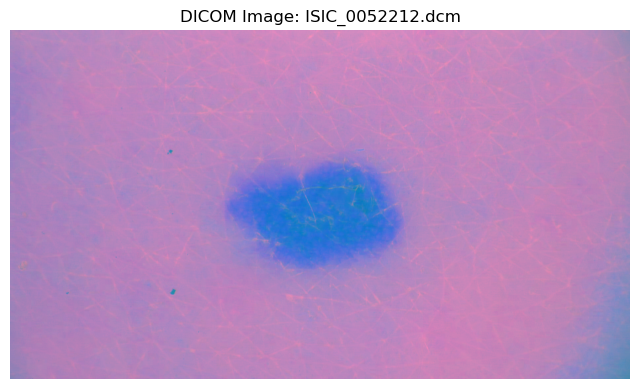

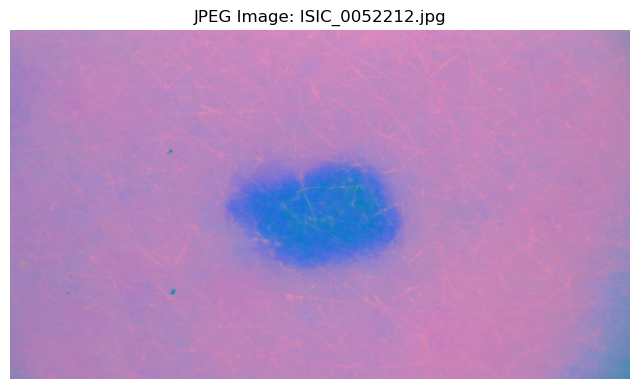

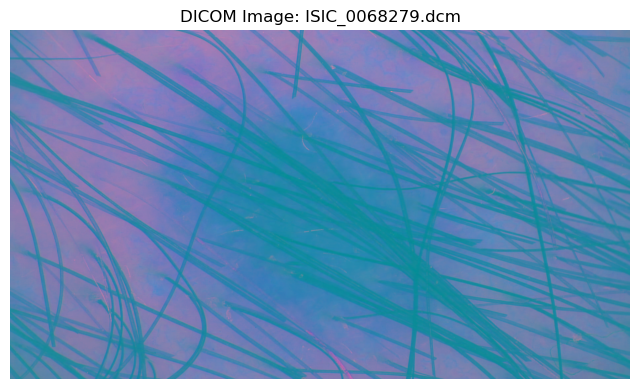

...

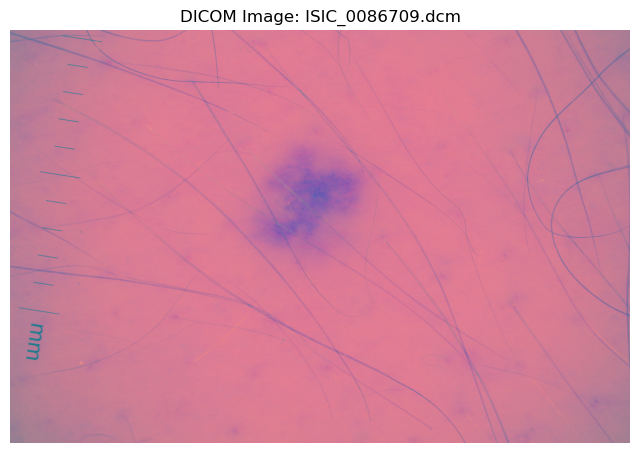

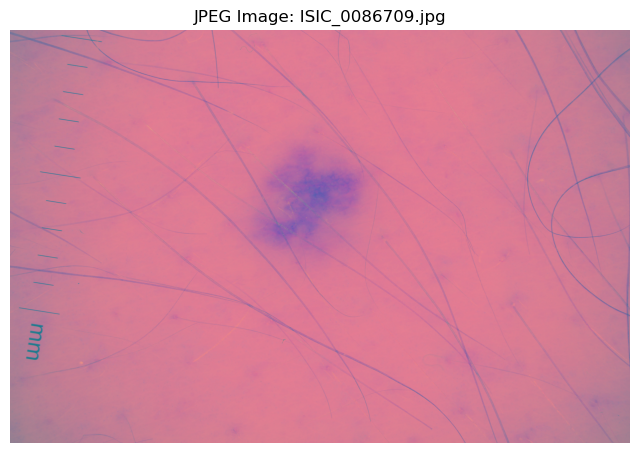

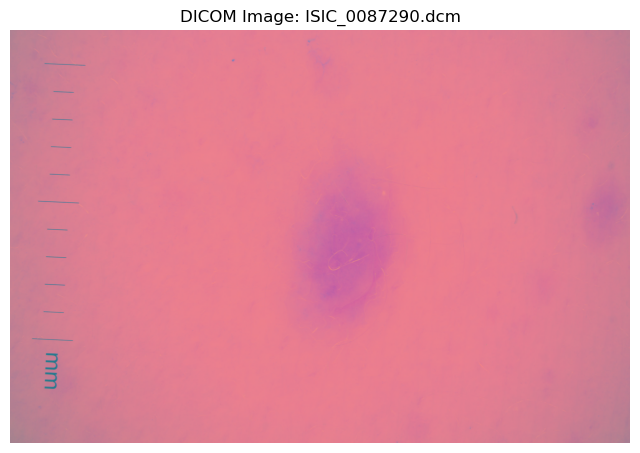

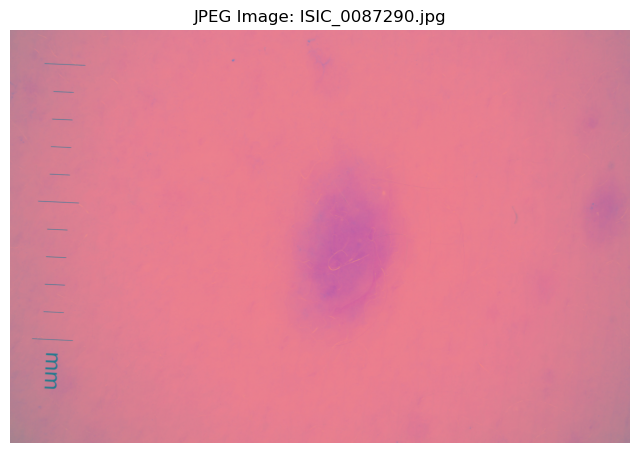

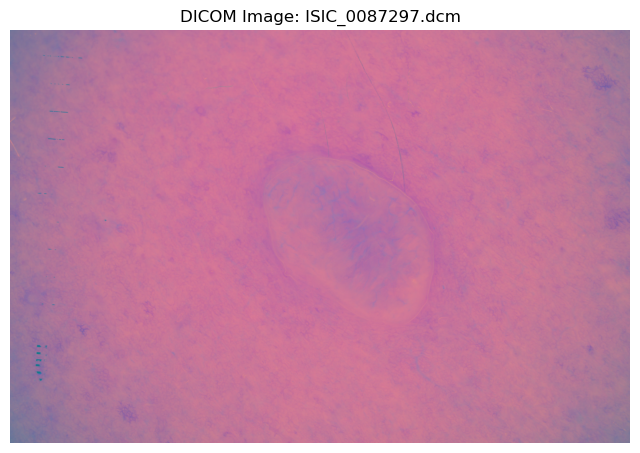

KeyboardInterrupt: 

In [11]:
import os
import pydicom
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

# Directory paths
dicom_dir = r'C:\Users\Praktikant\Thesis_Hafeez\Dataset\DICOM\dicom_files'
jpeg_dir = r'C:\Users\Praktikant\Thesis_Hafeez\Dataset\DICOM\dicom_to_jpeg'

# Create output directory if it doesn't exist
os.makedirs(jpeg_dir, exist_ok=True)

def visualize_image(image, title):
    plt.figure(figsize=(8, 8))
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')
    plt.show()

def convert_dicom_to_jpeg(dicom_path, jpeg_path):
    # Load DICOM file
    dicom_file = pydicom.dcmread(dicom_path)
    
    # Check if the DICOM image is in RGB format
    if 'PhotometricInterpretation' in dicom_file and dicom_file.PhotometricInterpretation == 'RGB':
        # Convert RGB DICOM image to a format that Pillow can use
        dicom_image = dicom_file.pixel_array
        dicom_image = np.clip(dicom_image, 0, 255).astype(np.uint8)  # Ensure the pixel values are in the range 0-255
    else:
        # Handle grayscale or other formats
        dicom_image = dicom_file.pixel_array
        dicom_image = dicom_image - np.min(dicom_image)
        dicom_image = dicom_image / np.max(dicom_image) * 255
        dicom_image = dicom_image.astype(np.uint8)

    # Create an image from the array
    image = Image.fromarray(dicom_image)
    
    # Ensure it's in RGB mode for JPEG
    if dicom_file.PhotometricInterpretation == 'RGB':
        image = image.convert('RGB')

    # Visualize the original DICOM image
    visualize_image(image, f'DICOM Image: {os.path.basename(dicom_path)}')

    # Save the image as JPEG
    image.save(jpeg_path, format='JPEG', quality=100)

    # Visualize the JPEG image
    jpeg_image = Image.open(jpeg_path)
    visualize_image(jpeg_image, f'JPEG Image: {os.path.basename(jpeg_path)}')

def process_dicom_directory(dicom_dir, jpeg_dir):
    for file_name in os.listdir(dicom_dir):
        if file_name.lower().endswith('.dcm'):
            dicom_path = os.path.join(dicom_dir, file_name)
            jpeg_path = os.path.join(jpeg_dir, file_name.replace('.dcm', '.jpg'))
            convert_dicom_to_jpeg(dicom_path, jpeg_path)

# Process all DICOM files in the directory
process_dicom_directory(dicom_dir, jpeg_dir)
